# DAT19 Lab 13
## Ensemble Methods: Aggregating Models


Today's lab covers:
1. Investigating the Decision Boundaries
2. Growing a Random Forest

The theory used to introduce these concepts can be a bit high level. We postulate a theoretical *true* classification **f** function that perfectly labels a data point given a large enough set of input features. We try to come as close as possible to this **f** with our learned classifier **h**. 

The concept of our *hypothesis space* is what we explore when we take our data, learn a model, and determine the "score" of our model. In theory, a cross validated score of 100 is as close as we can get to **f** and all these improvements we make to our classifiers are moving through the hypothesis space, approaching **f**.

This theoretical component has no true lab but in a sense is every lab that we've covered. Whenever we compare the performance of two separate models, we are comparing the difference from two distinct starting points in the hypothesis space.

A way to demonstrate this will be the basis of the first part of our lab.


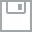
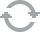
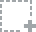
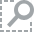
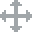
...
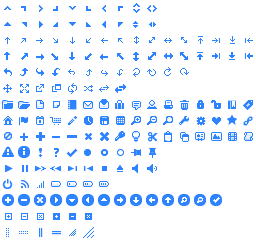
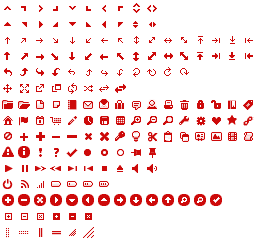
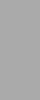
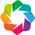
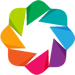

In [4]:
import numpy as np
import pandas as pd

from sklearn.cross_validation import train_test_split #splits data (like logistic regression)
from sklearn.preprocessing import StandardScaler #normalizes data
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neighbors import KNeighborsClassifier #a model
from sklearn.svm import SVC 
from sklearn.tree import DecisionTreeClassifier #decision tree model
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier 
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis  as LDA
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis  as QDA

from bokeh.plotting import figure,gridplot,show,output_notebook
from bokeh.models import Range1d
output_notebook()

%matplotlib inline

In [5]:
from sklearn.datasets import make_moons, make_circles, make_classification


##Investigating Decision Boundaries
Visually understanding how some classifiers make decisions; adapted from an sklearn page, which will be shared after lab. 

The goal here is to investigate the code and describe in layman's terms what is happening in the specific chunk. If there is a variable being referenced outside of your chunk, or your in a loop, refer to what's happening in one iteration of the loop.

In [6]:

# ====================================================================== #
# Part 1

names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", "Decision Tree",
         "Random Forest", "AdaBoost", "Naive Bayes", "LDA", "QDA"] #we have a list of names of the models we are using
classifiers = [
    KNeighborsClassifier(3), #the number of neighbors
    SVC(kernel="linear", C=0.025), #support vector classification. Not sure what this does.
    SVC(gamma=2, C=1), #not sure what this does. 
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    AdaBoostClassifier(),
    GaussianNB(),
    LDA(),
    QDA()]

X, y = make_classification(n_features=2, n_redundant=0, n_informative=2,
                           random_state=1, n_clusters_per_class=1) 

#make_classification:
#generate a random n-class classification problem. It introduces interdependence between these features
#and adds various types of further noise to the data


rng = np.random.RandomState(2) #2 is the seed, and exposes a number of methods for generating random numbers drawn
#from a variety of probability distributions.

X += 2 * rng.uniform(size=X.shape) #draws samples from a uniform distribution
#no defined values for 'low' or 'high';therefore, default value is 0 and 1

linearly_separable = (X, y)
#why did we make it a tuple?

datasets = [make_moons(noise=0.3, random_state=0),
            make_circles(noise=0.2, factor=0.5, random_state=1),
            linearly_separable
            ]

#all items within 'datasets' are simply classification data with their labels and their targets


In [7]:
#part 1

full_grid = [] #defined a list
for data in datasets: #datasets is 3 different data sets
    
# NOTE THIS IS A FOR LOOP, so decribe what happens on one iteration
# ====================================================================== #
# Part 2

    h = .02  # step size in the meshgrid
    
    X, y = data #first tuple
    X = StandardScaler().fit_transform(X) #helping better scale the dataset
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.4) #split

    x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5 #why are we subtracting 0.5 and adding 0.5 to the min and max?
    y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    
    raw = figure(title="Raw Data", tools='',
        x_range=(xx.min(), xx.max()), 
        y_range=(yy.min(), yy.max()),
        width=180, plot_height=220,
        min_border=1,
        title_text_font_size='10pt' )

    color_dict = {0:'blue',1:'red'} 

    train_colors = [color_dict[label] for label in y_train] #now all values in y_train are a string of 'blue' or 'red'
    raw.circle(X_train[:, 0], X_train[:, 1], 
               color=train_colors)

    test_colors = [color_dict[label] for label in y_test]
    raw.circle(X_test[:, 0], X_test[:, 1], 
               color=test_colors, alpha=0.6)


Describe here what is going on:

In [8]:
full_grid = []
for data in datasets:
    
# NOTE THIS IS A FOR LOOP, so decribe what happens on one iteration
# ====================================================================== #
# Part 2

    h = .02  # step size in the meshgrid
    
    X, y = data
    X = StandardScaler().fit_transform(X)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.4)

    x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
    y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

# ====================================================================== #
    # Part 3 
    #We are graphing the xx and yy.
    raw = figure(title="Raw Data", tools='',
                x_range=(xx.min(), xx.max()), 
                y_range=(yy.min(), yy.max()),
                width=180, plot_height=220,
                min_border=1,
                title_text_font_size='10pt' )

    color_dict = {0:'blue',1:'red'} 

    train_colors = [color_dict[label] for label in y_train] #now all values in y_train are a string of 'blue' or 'red'
    raw.circle(X_train[:, 0], X_train[:, 1], 
               color=train_colors)

    test_colors = [color_dict[label] for label in y_test]
    raw.circle(X_test[:, 0], X_test[:, 1], 
               color=test_colors, alpha=0.6)


    
# ====================================================================== #
# Part 4

    row=[raw] #what is this?
    for name, clf in zip(names, classifiers): 
        #seems like we are iterating with 2 variables
        #name = names
        #clf = classifiers
        clf.fit(X_train, y_train) #fitting each individual algorithm
        score = clf.score(X_test, y_test) #The score method:
        #Returns the mean accuracy on the given test data and labels.

        if hasattr(clf, "decision_function"): #what is this for?
            Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()])
        else:
            Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]

        
        Z = Z.reshape(xx.shape) #?
        Z = Z/Z.max() #?
        control_row = np.ones(Z.shape[1])+0.001
        #NOTE: control row adds a max value outside of the grid to correct colors. 
        # Don't worry about explaining control_row
        Z = np.vstack((Z,control_row)) #


# ====================================================================== #
# Part 5
        p1 = figure(title=name, tools='',
                    x_range=(xx.min(), xx.max()), 
                    y_range=(yy.min(), yy.max()),
                    width=180, plot_height=220,
                    min_border=1,
                    title_text_font_size='10pt')


        p1.image(image=[Z], x=[xx.min()], y=[yy.min()], dw=[xx.max()-xx.min()], dh=[yy.max()-yy.min()],
                palette='RdYlBu11')

        p1.circle(X_train[:, 0], X_train[:, 1], 
                  color=train_colors,
                  line_color='black',
                  size=3)
        p1.circle(X_test[:, 0], X_test[:, 1], 
                  color=test_colors, 
                  alpha=0.6,
                  line_color='black',
                  size=3)

        p1.text(x=[xx.max()-1.5],y=[yy.min()],
                text=[str(score)],
                text_font_size='15pt',
                text_font_style='bold')
        
        row.append(p1)
    
    grid = np.array(row).reshape(2,len(row)/2)
    full_grid.append(grid)
    
final_grid = np.vstack(full_grid)
show(gridplot(final_grid.tolist()))




### Random Forests
Random forests are a type of ensemble method (which we hinted at above) that build out groups of decision trees

In [9]:
from sklearn.cross_validation import ShuffleSplit #seems like this is needed for random forests

titanic = pd.read_csv('../data/titanic.csv')
titanic.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 891 entries, 0 to 890
Data columns (total 12 columns):
PassengerId    891 non-null int64
Survived       891 non-null int64
Pclass         891 non-null int64
Name           891 non-null object
Sex            891 non-null object
Age            714 non-null float64
SibSp          891 non-null int64
Parch          891 non-null int64
Ticket         891 non-null object
Fare           891 non-null float64
Cabin          204 non-null object
Embarked       889 non-null object
dtypes: float64(2), int64(5), object(5)
memory usage: 90.5+ KB


Let's preprocess our data. Age needs to be imputed or dropped, Sex needs to be converted to a boolean data type, and to use our categorical feature `Embarked` we must use `pd.get_dummies` on it

In [12]:
average_age = titanic['Age'].mean() #gives us the average of all the ages inputted
titanic['Age'] = titanic['Age'].fillna(average_age)

average_age

titanic

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.000000,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.000000,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.000000,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.000000,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.000000,0,0,373450,8.0500,NaN,S
5,6,0,3,"Moran, Mr. James",male,29.699118,0,0,330877,8.4583,NaN,Q
6,7,0,1,"McCarthy, Mr. Timothy J",male,54.000000,0,0,17463,51.8625,E46,S
7,8,0,3,"Palsson, Master. Gosta Leonard",male,2.000000,3,1,349909,21.0750,NaN,S
8,9,1,3,"Johnson, Mrs. Oscar W (Elisabeth Vilhelmina Berg)",female,27.000000,0,2,347742,11.1333,NaN,S
9,10,1,2,"Nasser, Mrs. Nicholas (Adele Achem)",female,14.000000,1,0,237736,30.0708,NaN,C


In [13]:
titanic['is_female'] = titanic.Sex=='female'

#creating a new list called 'is_female'
#throwing into that list all items of it being female

titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,is_female
0,1,0,3,"Braund, Mr. Owen Harris",male,22,1,0,A/5 21171,7.2500,NaN,S,False
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38,1,0,PC 17599,71.2833,C85,C,True
2,3,1,3,"Heikkinen, Miss. Laina",female,26,0,0,STON/O2. 3101282,7.9250,NaN,S,True
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35,1,0,113803,53.1000,C123,S,True
4,5,0,3,"Allen, Mr. William Henry",male,35,0,0,373450,8.0500,NaN,S,False


In [14]:
embarked_categories = pd.get_dummies(titanic.Embarked,prefix='Embarked')

#interesting way of adding another dataframe
#add in the column names into the index
#then set them equal to the values

titanic[embarked_categories.columns] = embarked_categories 
titanic.head()

#dont you have to drop one of them?

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,is_female,Embarked_C,Embarked_Q,Embarked_S
0,1,0,3,"Braund, Mr. Owen Harris",male,22,1,0,A/5 21171,7.2500,NaN,S,False,0,0,1
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38,1,0,PC 17599,71.2833,C85,C,True,1,0,0
2,3,1,3,"Heikkinen, Miss. Laina",female,26,0,0,STON/O2. 3101282,7.9250,NaN,S,True,0,0,1
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35,1,0,113803,53.1000,C123,S,True,0,0,1
4,5,0,3,"Allen, Mr. William Henry",male,35,0,0,373450,8.0500,NaN,S,False,0,0,1


In [19]:
feature_columns = 'Age,Parch,Pclass,Fare,Embarked_C,Embarked_Q,Embarked_S'.split(',') 
#why did we do it this way?

for train,test in ShuffleSplit(len(titanic),test_size=.2,n_iter = 1):
 
    X_train = titanic[feature_columns].iloc[train] #712
    y_train = titanic['Survived'].iloc[train] #712
    X_test = titanic[feature_columns].iloc[test] #179
    y_test = titanic['Survived'].iloc[test] #179
    

In [23]:
len(y_test)

179

In [25]:
# We already imported the RandomForest above, but here it is for reference:
# from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

rfc = RandomForestClassifier(max_depth=5, n_estimators=100, max_features=3) #RFC classifier
#n_estimators: the number of trees
#criterion: this is if we want to use gini/entropy
#max_depth: If none, then nodes are expanded until all leaves are pure.
#max_features: considers the maximum number of features at each split.


rfc.fit(X_train,y_train) #fit the data
rfc.score(X_test,y_test)

0.65921787709497204

This is an interesting general score but let's be more thorough and get a cross evaluation score, and see how it grows with the size of our forest (`n_estimators`).

In [26]:
from sklearn.cross_validation import cross_val_score

features = titanic[feature_columns] 
target = titanic['Survived']

forest_size = range(2,100,2) #range from 2 to 100 with a step of 2
y = []
for i in forest_size:
    rfc = RandomForestClassifier(max_depth=5, n_estimators=i, max_features=4)
    accuracy = cross_val_score(rfc, features, target, cv=5).mean()
    
    y.append(accuracy)
p1 = figure(title='Random Forest Classifier performance',tools='')
p1.line(x=forest_size,y=y, color='green')


show(p1)

How does the classifier change as we allow for more complexity?  (i.e. deeper trees)

In [28]:
tree_depth = range(1,50)
y = []
for i in tree_depth:
    rfc = RandomForestClassifier(max_depth=i, n_estimators=100, max_features=4) #changed the n_estimators to match above
    accuracy = cross_val_score(rfc, features, target, cv=5).mean()
    
    y.append(accuracy)
p1 = figure(title='Random Forest Classifier performance',x_axis_label='Max Tree Depth',tools='')
p1.line(x=tree_depth,y=y, color='green')


show(p1)

## Exercise: Random Forest Regression

In [29]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble.partial_dependence import plot_partial_dependence
from sklearn.cross_validation import train_test_split
import pandas as pd
from sklearn.preprocessing import LabelEncoder

%matplotlib inline
import matplotlib.pyplot as plt

In [56]:
df = pd.read_csv('../data/cell_phone_churn.csv')
df.head()

,state,account_length,area_code,intl_plan,vmail_plan,vmail_message,day_mins,day_calls,day_charge,eve_mins,eve_calls,eve_charge,night_mins,night_calls,night_charge,intl_mins,intl_calls,intl_charge,custserv_calls,churn
0,KS,128,415,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [57]:
# Some Preprocessing
state_encoder = LabelEncoder()  
df.state = state_encoder.fit_transform(df.state) #fit data and then does the transform
#each state now has a numeric value attributed to it. 

binary_columns = ['intl_plan', 'vmail_plan']  

df.intl_plan = df.intl_plan.map({'yes':1, 'no':0})
df.vmail_plan = df.vmail_plan.map({'yes':1, 'no':0})

df.head(10)

,state,account_length,area_code,intl_plan,vmail_plan,vmail_message,day_mins,day_calls,day_charge,eve_mins,eve_calls,eve_charge,night_mins,night_calls,night_charge,intl_mins,intl_calls,intl_charge,custserv_calls,churn
0,16,128,415,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,35,107,415,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,31,137,415,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,35,84,408,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,36,75,415,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False
5,1,118,510,1,0,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0,False
6,19,121,510,0,1,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,False
7,24,147,415,1,0,0,157.0,79,26.69,103.1,94,8.76,211.8,96,9.53,7.1,6,1.92,0,False
8,18,117,408,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False
9,49,141,415,1,1,37,258.6,84,43.96,222.0,111,18.87,326.4,97,14.69,11.2,5,3.02,0,False


Steps:
----
Explore the data and plot histograms of several columns. Hypothesize whether a relationship exists. 


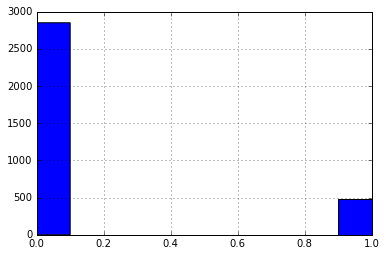

In [58]:
# To get you started:
df['churn'].hist()

Evaluate and compare the `precision and recall` of 
    - `GradientBoostingClassifier` 
    - `RandomForestClassifier`
    - `DecisionTreeClassifier`
    - `LogisticRegression`
        - hint!: use the `precision_recall_fscore_support` built into sklearn 

In [74]:
#ShuffleSplit is used for random forests as it's not guaranteed that datapoints will be unique

from sklearn.metrics import classification_report,confusion_matrix

target = df['churn']
features = df.drop(['churn'], axis = 1)
features_fit = StandardScaler().fit_transform(features)

X_train, X_test, y_train, y_test = train_test_split(features_fit, target, test_size=0.2, random_state=1)

#from sklearn.tree import DecisionTreeClassifier
#from sklearn.ensemble import RandomForestClassifier
#from sklearn.linear_model import LogisticRegression
#from sklearn.ensemble.partial_dependence import plot_partial_dependence
#from sklearn.cross_validation import train_test_split


In [115]:
#LOGISTIC REGRESSION

model_lgr = LogisticRegression(C = 1)
model_lgr.fit(X_train,y_train)
model_lgr_predictions = model_lgr.predict(X_test)

#score_lgr = cross_val_score(model_lgr, features, target,cv = 3).mean()
score_lgr = cross_val_score(model_lgr, X_train, y_train,cv = 3).mean()
score_lgr #0.86009

cm_lgr = confusion_matrix(y_test, model_lgr_predictions)
cm_lgr

lgr_prec, lgr_recall, lgr_fbeta, lgr_supp = precision_recall_fscore_support(y_test, model_lgr_predictions)

print lgr_prec #how do I interpret this?
print lgr_recall

[ 0.87539432  0.48484848]
[ 0.97027972  0.16842105]


In [87]:
#DECISION TREES PT.1

treeclf_scores = []

for i in range(1,len(features.columns)):
    treeclf = DecisionTreeClassifier(max_depth = i, random_state = 1) #increase depth to 10
    treeclf.fit(X_train, y_train)
    clf_score = cross_val_score(treeclf, X_train, y_train, cv = 3).mean()
    treeclf_scores.append(clf_score)
    
#treeclf_scores 
#after running for-loop, we see highest value at max_depth = 7
#0.938852



In [119]:
#DECISION TREES PT.2

#Apply above information of best cross_val_score at a max_depth of 7

treeclf = DecisionTreeClassifier(max_depth = 7, random_state = 1) #increase depth to 10
treeclf.fit(X_train, y_train)
treeclf_predictions = treeclf.predict(X_test)
#clf_score = cross_val_score(treeclf, X_train, y_train, cv = 3).mean()

cm_treeclf = confusion_matrix(y_test, treeclf_predictions)
cm_treeclf

lgr_prec, lgr_recall, lgr_fbeta, lgr_supp = precision_recall_fscore_support(y_test, treeclf_predictions)

print lgr_prec #how do I interpret this?
print lgr_recall

[ 0.94463087  0.87323944]
[ 0.98426573  0.65263158]


In [97]:
#RANDOM FOREST PT. 1
#need to re-do our test data to be of random

#have we defined train and test?

for train,test in ShuffleSplit(len(features),test_size=.2,n_iter = 1):
 
    X_train = features.iloc[train] #2666
    y_train = target.iloc[train] 
    X_test = features.iloc[test] 
    y_test = target.iloc[test] #667


In [106]:
#RANDOM FOREST PT. 2

tree_depth = range(1,50)
y = []
for i in tree_depth:
    rfc = RandomForestClassifier(max_depth=i, n_estimators=100, max_features=4) #changed the n_estimators to match above
    rfc.fit(X_train, y_train)
    accuracy = cross_val_score(rfc, X_train, y_train, cv=5).mean()
    
    y.append(accuracy)
    
p1 = figure(title='Random Forest Classifier performance',x_axis_label='Max Tree Depth',tools='')
p1.line(x=tree_depth,y=y, color='green')



show(p1)

In [111]:
#RANDOM FOREST PT. 3

for value in range(len(y)):
    if(y[value] == max(y)):
        max_index = value #this is the max index
        
print max_index #having 40 is supposedly the highest.
print y[max_index] #much better, with a cross_val_score of 0.95573

40
0.955739066768


In [120]:
#RANDOM FOREST PT. 4

rfc = RandomForestClassifier(max_depth=40, n_estimators=100, max_features=4)
rfc.fit(X_train, y_train)
rfc_predictions = rfc.predict(X_test)

rfc_cm = confusion_matrix(y_test, rfc_predictions)
rfc_cm

lgr_prec, lgr_recall, lgr_fbeta, lgr_supp = precision_recall_fscore_support(y_test, rfc_predictions)

print lgr_prec #how do I interpret this?
print lgr_recall

[ 0.94789916  0.88888889]
[ 0.98601399  0.67368421]


In [69]:
from sklearn.ensemble import GradientBoostingClassifier
#help(precision_recall_fscore_support)
#Computes precision, recall, F-measure and support for each class
#parameters: y_true / y_pred / labels (optional)


#n_estimators at 100

model_gbc = GradientBoostingClassifier() #have to instantiate (?) it first
model_gbc.fit(features,target)


model_rfc = RandomForestClassifier()
model_rfc.fit(features,target)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

Tune the models using a grid-search of several parameters 
    - Determine which score (accuracy? F1 score? ...) you will use for your grid search. Explain why to your partner
    - Hint: for `DecisionTreeClassifier` and `RandomForestClassifier`, 
        look at the docs to see which hyperparameters need tuning.  



Plot feature importance for one of your models (using the `.feature_importances_` property)
    - Hint: load `feature_importances_` into a `pandas.Series` and use `.plot(kind='barh')` 


5 Plot a learning curve for the same model
    - Hint: This one is tough! Remember that a learning curve is the cross_validation score of a model on the training and test sets as the model learns more and more data.

In [ ]:
#Your Code here






